Place your input

In [1]:
import plotly.plotly as py
import jsonlines
file = open("Results.txt","r")
scores=file.readlines()
file.close()
labellist=[]
genrelist=[]
sentencepairs=[]
with jsonlines.open("multinli_1.0_dev_matched.jsonl") as f:
    for item in f:
        labellist.append(item['gold_label'])
        genrelist.append(item['genre'])
        sentencepairs.append([item['sentence1'],item['sentence2']])

In [2]:
#Creates an array for each possible treshold,
#Then stores the evaluated results in a list in each slot

Accuracies=[]
Contra_Prec=[]
Contra_Rec=[]
Contra_Fscore=[]
Neutral_Prec=[]
Neutral_Rec=[]
Neutral_Fscore=[]
Entail_Prec=[]
Entail_Rec=[]
Entail_Fscore=[]


for point in range(1,999):
    threshold=point/1000
    Results=[]
    for score in scores:
        if abs(float(score))>threshold:
            if float(score)>0:
                Result="entailment"
            if float(score)<0:
                Result="contradiction"
        if abs(float(score))<threshold:
            Result="neutral"
        Results.append(Result)
    
    all=0
    success = 0
    True_Hit_Entailment = 0
    True_Hit_Neutral = 0
    True_Hit_Contradiction = 0
    Judged_Entailment_When_Neutral = 0
    Judged_Entailment_When_Contradiction = 0
    Judged_Contradiction_When_Neutral = 0
    Judged_Contradiction_When_Entailment = 0
    Judged_Neutral_When_Contradiction = 0
    Judged_Neutral_When_Entailment = 0
    outliers=[]
        
    for i,Result in enumerate(Results):
        all+=1
        if Result=='entailment' and labellist[i]== 'entailment':
            True_Hit_Entailment+=1
            success+=1
        if Result=='contradiction' and labellist[i]== 'contradiction':
            True_Hit_Contradiction+=1
            success+=1
        if Result=='neutral' and labellist[i]== 'neutral':
            True_Hit_Neutral+=1
            success+=1
        if Result=='contradiction' and labellist[i]== 'neutral':
            Judged_Contradiction_When_Neutral+=1
            if point>950:
                outliers.append(i)
        if Result=='contradiction' and labellist[i]== 'entailment':
            Judged_Contradiction_When_Entailment+=1
        if Result=='neutral' and labellist[i]== 'contradiction':
            Judged_Neutral_When_Contradiction+=1
            if point<50:
                outliers.append(i)
        if Result=='neutral' and labellist[i]== 'entailment':
            Judged_Neutral_When_Entailment+=1
            if point<50:
                outliers.append(i)
        if Result=='entailment' and labellist[i]== 'contradiction':
            Judged_Entailment_When_Contradiction+=1
        if Result=='entailment' and labellist[i]== 'neutral':
            Judged_Entailment_When_Neutral+=1
            if point>950:
                outliers.append(i)
        if labellist[i]!='entailment' and labellist[i]!='contradiction' and labellist[i]!='neutral':
            outliers.append(i)
            
    #Calculating statistics
    
    TPN=True_Hit_Neutral
    FPN=Judged_Neutral_When_Entailment+Judged_Neutral_When_Contradiction
    FNN=Judged_Contradiction_When_Neutral+Judged_Entailment_When_Neutral
    TNN=all-TPN-FPN-FNN
    
    TPC=True_Hit_Contradiction
    FPC=Judged_Contradiction_When_Entailment+Judged_Contradiction_When_Neutral
    FNC=Judged_Neutral_When_Contradiction+Judged_Entailment_When_Contradiction
    TNC=all-FNC-FPC-TPC    

    TPE=True_Hit_Entailment
    FPE=Judged_Entailment_When_Neutral+Judged_Entailment_When_Contradiction
    FNE=Judged_Contradiction_When_Entailment+Judged_Neutral_When_Entailment
    TNE=all-FPE-TPE-FNE
    
    try:
        CPrec=TPC/(TPC+FPC)
    except ZeroDivisionError:
        CPrec=0
        
    try:
        CRec=TPC/(TPC+FNC)
    except ZeroDivisionError:
        CRec=0
        
    try:
        Fscore_C=2/(1/CPrec+1/CRec)
    except ZeroDivisionError:
        Fscore_C=0
        
    try:    
        EPrec=TPE/(TPE+FPE)
    except ZeroDivisionError:
        EPrec=0
        
    try: 
        ERec=TPE/(TPE+FNE)
    except ZeroDivisionError:
        ERec=0
        
    try:
        Fscore_E=2/(1/EPrec+1/ERec)
    except ZeroDivisionError:
        Fscore_E=0
        
    try:
        NPrec=TPN/(TPN+FPN)
    except ZeroDivisionError:
        NPrec=0
        
    try:
        NRec=TPN/(TPN+FNN)
    except ZeroDivisionError:
        NRec=0
        
    try:
        Fscore_N=2/(1/NPrec+1/NRec)
    except ZeroDivisionError:
        Fscore_N=0
        
    Accuracies.append(success/all)
    Contra_Prec.append(CPrec)
    Contra_Rec.append(CRec)
    Contra_Fscore.append(Fscore_C)
    Neutral_Prec.append(NPrec)
    Neutral_Rec.append(NRec)
    Neutral_Fscore.append(Fscore_N)
    Entail_Prec.append(EPrec)
    Entail_Rec.append(ERec)
    Entail_Fscore.append(Fscore_E)
    
    

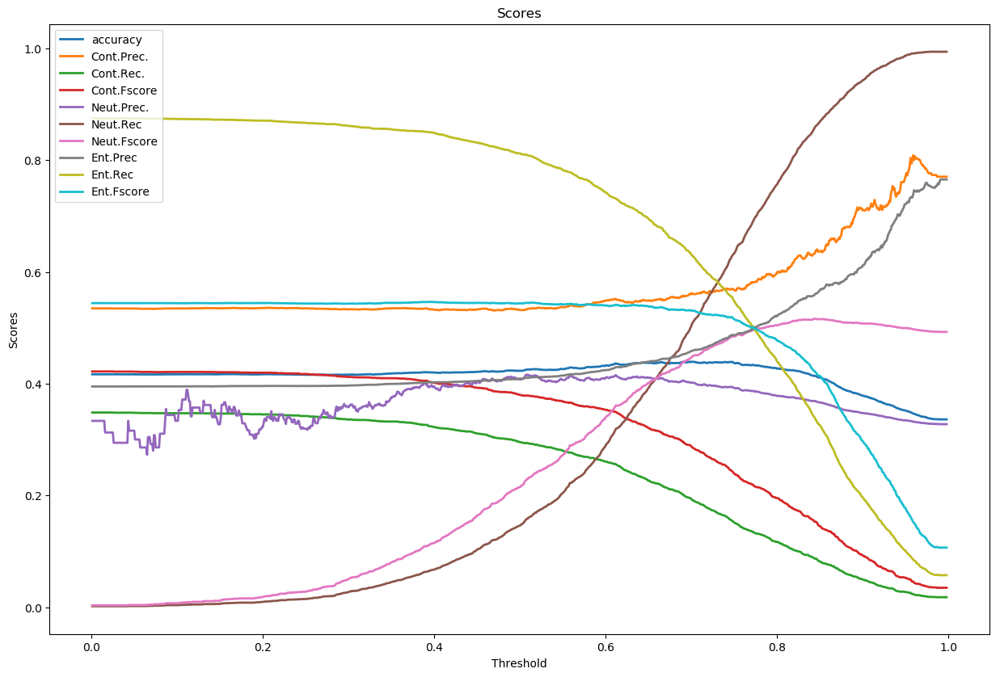

In [3]:
#Plotting

from matplotlib import pyplot as plt

threshold=[x/1000 for x in range(1,999)]
fig = plt.figure(figsize=(15, 10), dpi=100)
plt.plot(threshold,Accuracies,label='accuracy',linewidth=2)
plt.plot(threshold,Contra_Prec,label='Cont.Prec.',linewidth=2)
plt.plot(threshold,Contra_Rec,label='Cont.Rec.',linewidth=2)
plt.plot(threshold,Contra_Fscore,label='Cont.Fscore',linewidth=2)
plt.plot(threshold,Neutral_Prec,label='Neut.Prec.',linewidth=2)
plt.plot(threshold,Neutral_Rec,label='Neut.Rec',linewidth=2)
plt.plot(threshold,Neutral_Fscore,label='Neut.Fscore',linewidth=2)
plt.plot(threshold,Entail_Prec,label='Ent.Prec',linewidth=2)
plt.plot(threshold,Entail_Rec,label='Ent.Rec',linewidth=2)
plt.plot(threshold,Entail_Fscore,label='Ent.Fscore',linewidth=2)

plt.legend()

plt.title('Scores')
plt.xlabel('Threshold')
plt.ylabel('Scores')

plt.show()

In [8]:
#Evaluating based on just Neutral and not Neutral
RelPrec=[]
RelRec=[]
Fscores_R=[]
Acc=[]

for point in range(1,999):
    threshold=point/1000
    Results=[]
    for score in scores:
        if abs(float(score))>threshold:
            if float(score)>0:
                Result="entailment"
            if float(score)<0:
                Result="contradiction"
        if abs(float(score))<threshold:
            Result="neutral"
        Results.append(Result)
    
    all=0
    success = 0
    True_Hit_Entailment = 0
    True_Hit_Neutral = 0
    True_Hit_Contradiction = 0
    Judged_Entailment_When_Neutral = 0
    Judged_Entailment_When_Contradiction = 0
    Judged_Contradiction_When_Neutral = 0
    Judged_Contradiction_When_Entailment = 0
    Judged_Neutral_When_Contradiction = 0
    Judged_Neutral_When_Entailment = 0
 
        
    for i,Result in enumerate(Results):
        all+=1
        if Result=='entailment' and labellist[i]== 'entailment':
            True_Hit_Entailment+=1
            success+=1
        if Result=='contradiction' and labellist[i]== 'contradiction':
            True_Hit_Contradiction+=1
            success+=1
        if Result=='neutral' and labellist[i]== 'neutral':
            True_Hit_Neutral+=1
            success+=1
        if Result=='contradiction' and labellist[i]== 'neutral':
            Judged_Contradiction_When_Neutral+=1
         
        if Result=='contradiction' and labellist[i]== 'entailment':
            Judged_Contradiction_When_Entailment+=1
            success+=1
        if Result=='neutral' and labellist[i]== 'contradiction':
            Judged_Neutral_When_Contradiction+=1
  
        if Result=='neutral' and labellist[i]== 'entailment':
            Judged_Neutral_When_Entailment+=1

        if Result=='entailment' and labellist[i]== 'contradiction':
            Judged_Entailment_When_Contradiction+=1
            
        if Result=='entailment' and labellist[i]== 'neutral':
            Judged_Entailment_When_Neutral+=1

        if labellist[i]!='entailment' and labellist[i]!='contradiction' and labellist[i]!='neutral':
            outliers.append(i)
            
    #Calculating statistics
    
    
    TPR=True_Hit_Contradiction + True_Hit_Entailment + Judged_Contradiction_When_Entailment + Judged_Entailment_When_Contradiction
    FPR=Judged_Entailment_When_Neutral+Judged_Contradiction_When_Neutral
    FNR=Judged_Neutral_When_Contradiction+Judged_Neutral_When_Entailment
    TNR=all-FNR-FPR-TPR    

    
    try:
        RPrec=TPR/(TPR+FPR)
    except ZeroDivisionError:
        RPrec=0
        
    try:
        RRec=TPR/(TPR+FNR)
    except ZeroDivisionError:
        RRec=0
        
    try:
        Fscore_R=2/(1/RPrec+1/RRec)
    except ZeroDivisionError:
        Fscore_R=0
    
    RelPrec.append(RPrec)
    RelRec.append(RRec)
    Fscores_R.append(Fscore_R)
    Acc.append(success/all)

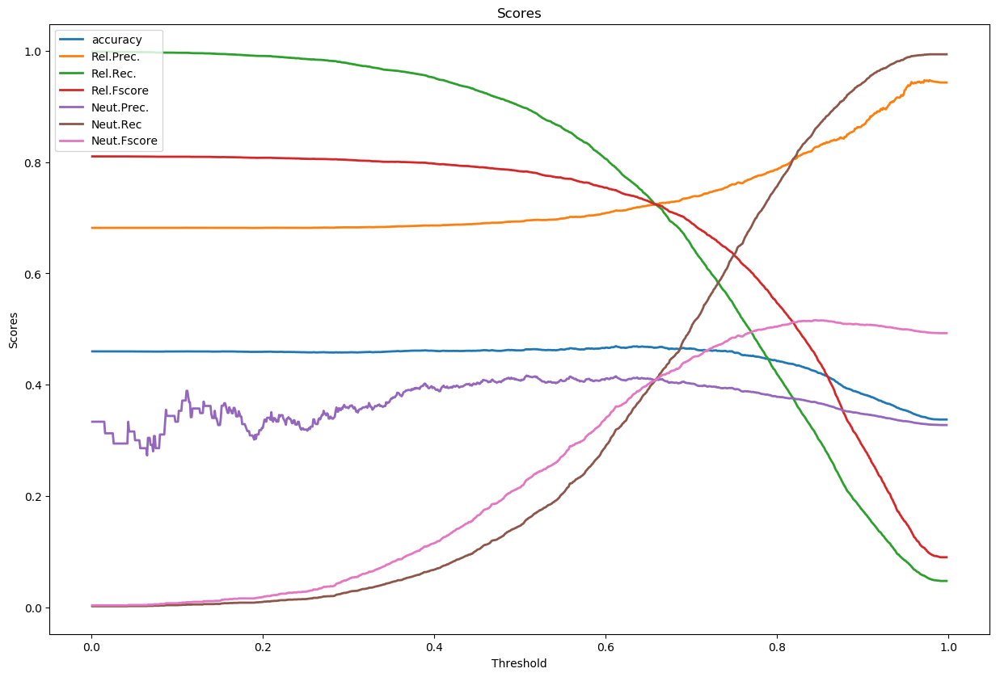

In [9]:
threshold=[x/1000 for x in range(1,999)]
fig2 = plt.figure(figsize=(15, 10), dpi=100)
plt.plot(threshold,Acc,label='accuracy',linewidth=2)
plt.plot(threshold,RelPrec,label='Rel.Prec.',linewidth=2)
plt.plot(threshold,RelRec,label='Rel.Rec.',linewidth=2)
plt.plot(threshold,Fscores_R,label='Rel.Fscore',linewidth=2)
plt.plot(threshold,Neutral_Prec,label='Neut.Prec.',linewidth=2)
plt.plot(threshold,Neutral_Rec,label='Neut.Rec',linewidth=2)
plt.plot(threshold,Neutral_Fscore,label='Neut.Fscore',linewidth=2)

plt.legend()

plt.title('Scores')
plt.xlabel('Threshold')
plt.ylabel('Scores')

plt.show()

In [6]:
# Outliers:
for strange in outliers:
    print(sentencepairs[strange], genrelist[strange])

['They consolidated programs to increase efficiency and deploy resources more effectively', 'Programs to increase efficiency were consolidated, because they care deeply about efficiency. '] government
['It profiles a new kind of office superstore-cum-hotel that sells generic office space to lonely telecommuters.', 'Telecommuters buy generic office space.'] slate
['Down the street from the statue is the Bank of Ireland , built in 1729 to house the Irish parliament.', "The Bank of Ireland's location used to be that of the Irish parliament."] travel
['Generally, data collection and analysis are concurrent and interactive-that is, yoked in case study methods.', 'Data analysis includes case studies '] government
['Even today, Yanomamo men raid villages, kill men, and abduct women for procreative purposes.', 'Yanomamo is a terrorist.'] slate
['In 1982, Wallace won his last race for governor with a quarter of the black votes cast in the Democratic primary, a fact alluded to in a written epilo

["Where alternative country runs into trouble is its tendency to ignore what's durable about country in favor of its stereotypical hay-bales-and-whiskey-bottles shtick.", 'Stereotypical things like whiskey bottles and hay-bales represents alternative country.'] slate
['Perhaps North Africans and eastern Europeans peopled the Ligurian coast, while the Adriatic and south may have been settled by people from the Balkans and Asia Minor.', 'North Africans and eastern Europeans eagerly accepted the prospect of staying where they were, while those from Asia Minor and the Balkins settled on the Lingurian coast.'] travel
["I still didn't trust the little buggers.", 'Due to past experiences, I could not trust the small creatures I saw.'] fiction
["Civil libertarians denounced it as an improper church-state partnership, a sectarian scheme to milk the taxpayer, and a feel-good diversion from the rest of the coalition's agenda.", 'The coalition has been distracted from its agenda.'] slate
['The chu

['The Times says this tracking list is drawn up from information from bookstores, but publishers say they routinely call up the Times to tip them off to books selling with increasing momentum so that they can be added to the tracking list.', 'Times confesses to publishers calling them to tell them of best selling books.'] slate
["He says he brought the proposal for professional parachute helmets with an air-bag system.'", 'He purchased the professional parachute helmet proposal.'] fiction
['Postal Service data to define the relationship between costs and cost drivers.', 'Postal Service data is used to define the relationship between cost and inflation.'] government
['Unrest and some political extremism have surfaced from time to time, but since aid from France is so vital, and French customs so ingrained, it seems almost inconceivable that the FWI will seek total independence as other Caribbean islands have done.', 'There is a great deal of political extremism.'] travel
["yeah TI peopl

['In 1982, Wallace won his last race for governor with a quarter of the black votes cast in the Democratic primary, a fact alluded to in a written epilogue at the end of the film.', 'Wallace was not reelected as governor.'] slate
["I guess he thought you'd turned up your toes.", "He knew that you'd turned up your toes."] fiction
['What a brilliantly innocuous metaphor, devised by a master manipulator to obscure his manipulations.', 'The simile was created by the manipulator.'] slate
['Other functional components of the Postal Service are presumed here not to exhibit significant scale economies, although this has not been demonstrated.', 'The Postal Service has very small scale economies.'] government
['There are other reasons that wrecks cause fan excitement--e.g.', 'A cause for fan excitement can be wrecks. '] slate
['Do you want to see historic sights and tour museums and art galleries?', "You wouldn't like to visit historic places, museums, and art galleries, would you?"] travel
['D

["but uh that has been the major change that we have noticed in gardening and that's about the extent of what we've done just a little bit on the patio and uh and waiting for the the rain to subside so we can  mow we after about a month we finally got to mow this weekend", 'We hope to get a lot more gardening done now that the rain has stopped.'] telephone
["In DOD's current acquisition environment, the customer is willing to trade time and money for the highest performing weapon system possible.", 'Time and money take precedence over the performance of the weapon system itself.'] government
['It has a full program of events, including lectures.', 'There might be some lectures in the very full docket of events.'] travel
["A poll of Hong Kong residents finds them sanguine about the city's future.", "Although the situation is dismal, most Hong Kong residents are optimistic about the city's future. "] slate
['8. Jury Nullification.', "The jury cannot make a decision contrary to the judge'

['32 Under the RSA proposal, a worker between the ages of 25 and 60 with family earnings of at least $5,000 could contribute up to $1,000 annually through either an employer-sponsored saving plan or a tax-deferred individual account.', 'Workers under 25 earning less than $5000 could contribute to a tax-deferred individual savings account.'] government
['yeah now do Indian are Indian foods kosher', 'No, indian foods are not kosher.'] telephone
['any bad stuff so uh i think TI we spend of of of all the major semiconductor firms we probably put safety and environmental on the utmost foremost uh uh first thing we always look at and we probably put more money into the systems and engineering behind the systems than any other firm i know of we eat and sleep the stuff everything we do over here and uh', 'All the major semiconductor firms tend to spend more money than we do on safety, environmental concerns, and the engineering behind the systems.'] telephone
['And far, far away- lying still o

['The much-previewed profile of Michael Huffington reveals that he is--surprise, surprise--gay.', 'The profiling was a much anticipated release.'] slate
["right right well you know i think uh i think it's going to happen i don't know i don't know what else i could suggest to them you know if they ask me what should we do i don't know i wouldn't know what else to suggest to them just education start with these little kids you know and like you said you know start making it practice you know start showing all the street signs and all the cars of course i think all the cars are manufactured that way they aren't aren't all of them most o f the new ones i'm seeing are are made with miles per hour and kilometers on them", 'Educating the kids to learn and practice and not manufacturing cars with miles per hour to make it happen.'] telephone
['um-hum yeah right uh is yours a is it a a slab foundation or pier and beam', 'Your foundation is a slab.'] telephone
['I think this report shows that we

["Off El Hurriya Street you'll find the Neo-Classical facade of the Greco-Roman Museum with a fine collection of both Roman, Greek, and Ptolemaic artifacts found around the city and under the waters of the harbor, along with many ancient Egyptian pieces.", 'In the Museum you will find objects from allover from the local areas.'] travel
['Poirot remained lost in thought for a few minutes. ', 'Poirot had trouble remaining focused.'] fiction
["in you know just dealing with the customer maybe that's there only reason why they don't it'd seem like they'd just put a little barrel out there and say it pour here and go on  we'll take your money", 'I know just having to put up with the customer is the only reason.'] telephone
['Enlarging the village was not desirable and most knew that Severn only desired wealth and a seat on the council of elders.', 'Severn only cared about being  a millionaire.'] fiction
['Missouri was asked to continue its planning efforts and file a supplemental planning re

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


slate
["I guess he thought you'd turned up your toes.", "He knew that you'd turned up your toes."] fiction
['What a brilliantly innocuous metaphor, devised by a master manipulator to obscure his manipulations.', 'The simile was created by the manipulator.'] slate
['Other functional components of the Postal Service are presumed here not to exhibit significant scale economies, although this has not been demonstrated.', 'The Postal Service has very small scale economies.'] government
['There are other reasons that wrecks cause fan excitement--e.g.', 'A cause for fan excitement can be wrecks. '] slate
['Do you want to see historic sights and tour museums and art galleries?', "You wouldn't like to visit historic places, museums, and art galleries, would you?"] travel
['During the hottest hours, things come to a virtual standstill, though the Caribbean siesta is an hour or two shorter than its Mediterranean counterpart.', 'During the most popular hours was when things came to a standstill.']

['… I saw that I must lead two lives.', "There was no shortage of complexity to the issue at hand, but it wasn't one that couldn't be solved by one well-thought out track. "] fiction
['no North Carolina State', 'There is no state called North Carolina'] telephone
["Game-trackers will be out by this time in an attempt to locate the tiger's hunting ground for the evening safari.", 'Trackers wake up early to locate the tigers for the safari.'] travel
['no no but you know i was just thinking of getting one those for the yard because they they are really nice and um up here we have uh we have quite a few mosquitoes at nighttime', 'I was considering getting one of those for my home.'] telephone
['To make matters worse, many employers looking to save money (and please their employees) will drop dependent benefits if states provide better coverage than the private plans now do.', 'But the upside is that if states provide better coverage than private plans, many employers will drop dependent be

['Generally, data collection and analysis are concurrent and interactive-that is, yoked in case study methods.', 'Data analysis includes case studies '] government
['Even today, Yanomamo men raid villages, kill men, and abduct women for procreative purposes.', 'Yanomamo is a terrorist.'] slate
['In 1982, Wallace won his last race for governor with a quarter of the black votes cast in the Democratic primary, a fact alluded to in a written epilogue at the end of the film.', 'Wallace was not reelected as governor.'] slate
["I guess he thought you'd turned up your toes.", "He knew that you'd turned up your toes."] fiction
['What a brilliantly innocuous metaphor, devised by a master manipulator to obscure his manipulations.', 'The simile was created by the manipulator.'] slate
['Other functional components of the Postal Service are presumed here not to exhibit significant scale economies, although this has not been demonstrated.', 'The Postal Service has very small scale economies.'] govern

['Emergency physician attitudes concerning intervention for alcohol abuse/dependence in the emergency department.', 'Most physicians support substance abuse intervention in the ER.'] government
['Are you sure?', "Aren't you indecisive?"] fiction
['Down the street from the statue is the Bank of Ireland , built in 1729 to house the Irish parliament.', 'Bank of Ireland is int the same building as the Irish parliament.'] travel
['You will find two principal  fino and olorose', 'There is only two fino and olorose to find.'] travel
['On the left of the entrance ramp is the open space once occupied by the Temple of Athena, close to which are the remains of the Pergamene library.', 'The entrance ramp leads to a model of the Temple of Athena.'] travel
[' 13-year-olds.', 'Kids in middle school'] slate
["They encourage the view that there's nothing--from Iraqi germ weapons programs to Serbian atrocities--that a few invisible planes can't fix.", 'A few invisible planes are all it takes to fix cert

['Five years ago, Speaker-elect Newt Gingrich promised to make important information available online at the same moment that it is available to the highest-paid Washington lobbyist.', 'Newt Gingrich promised that the lobbyists will post important information online. '] slate
['It was other-worldly.', 'It was very good.'] fiction
['it may be arrogant but i mean let them come to us', 'It is definitely arrogant to suggest that they should come to us'] telephone
["oh i don't know either the other growing up all i knew was", 'When I was young the only thing I knew was'] telephone
['Personal Communication with P. Croteau, Babcock Borsig Power, August 2001.', 'In July 2009, there was personal communication between P. Croteau and Babcock Borsig Power.'] government
[', number of parks or acres of land) rather than in terms of historical cost.', 'Parks have a historical cost that might be expressed based on acreage.'] government
['Emergency physician attitudes concerning intervention for alcoho

['Another quarter billion plus dollars of the total amount sought was earmarked to pay down operating debt accrued in past years.', 'Another quarter billion dollars or more was earmarked to pay down debt incurred by the building.'] government
['The final rule was determined to be an economically significant regulatory action by the Office of Management and Budget and was approved by OMB as complying with the requirements of the Order on March 26, 1998.', 'The final rule was declared an economically significant regulator action by the EPA.'] government
['External Validity The extent to which a finding applies (or can be generalized) to persons, objects, settings, or times other than those that were the subject of study.', 'External validity is about testing conclusions on more individuals in order to confirm the initial hypothesis.'] government
['In the USPS view of the world, institutional costs are a larger share of total costs and fewer costs can be expected to be shed, if and when, 

['He caught his breath.', 'He was flustered.'] fiction
['and those are the people that you know can you rehabilitate them the some of the ones that are you know perpetual', 'Anyone can be rehabilitated no matter the crime.'] telephone
['It was always a part of me.', 'Even though it is not true anymore, back then it was a portion of me.'] government
["They aren't breaking any promises if they decide to take their ball and go home.", 'They promised to take their ball and go home.'] slate
['Unless the mention of the Ritz was an accidental remark?"', 'Was the mention of the Ritz intentional?'] fiction
['(Hypothetical data for this example are given in table 2.2.)', 'The data exists '] government
['One possible explanation is that surging household wealth in recent years contributed to the virtual disappearance of personal saving.', 'The disappearance of saving on a personal level may be the reason why household wealth has continued to go up in recent years.'] government
['uh unemployment r

['So let me draw a slightly different moral from the saga of beach volleyball as it has evolved in our  If, as Speaker Gingrich says, the price of volleyball is eternal freedom, still it may take a village to raise a volleyball net.', 'Speaker Gingrich believes that volleyball is an important thing to consider when discussing freedom. '] slate
["They aren't breaking any promises if they decide to take their ball and go home.", 'They can take their ball and go sit around at home without breaking any promises to anyone.'] slate
['As a result, their services may be more effective when conducted in the emergency department environment.', "Their services might be more effective if they're done in the ED during a trauma."] government
['Don Saunders attended from the NLADA.', 'The NCAAP sent Saunders.'] government
["Sure, the man yells back, you're in a hot air balloon about 30 feet above this field.", 'You are inna hot air balloon with a man telling at yuou angrily '] government
['Lawyers in

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['Missouri was asked to continue its planning efforts and file a supplemental planning report with LSC on or before October 1, 1999.', 'Missouri had made planning efforts prior to being asked. '] government
['we only have to get up for you know for the daytime feedings', 'We have to get up early to prepare the daytime feedings.'] telephone
['But in all probability the girl will have entirely forgotten the intervening period, and will take up life where she left off at the sinking of the Lusitania."', 'There is a chance the girl will remember that period.'] fiction
["Despite its initial failings, Siegel's Flamingo survived him, as did mob infiltration of casinos.", 'The initial failings that Siegel experienced survived him.'] travel
['Peel Edgerton.', 'Remove the outer layer first.'] fiction
['Twenty-eight grants targeted statewide web sites, which encompass not only all of the LSC programs in a state, but other state justice community partners.', 'A grant is a sum of money.'] governmen

['But the arguments that it would do harm seem unpersuasive.', 'People thought this was harmless regardless of the reports. '] slate
['iii Program Letter 1998-1, published on February 12, 1998, called upon all LSC recipients to analyze any progress made toward the development of the legal services model envisioned by state planners.', 'State planners provide contract services to analyze LSC recipients legal models.'] government
['Why bother to sacrifice your lives for dirt farmers and slavers?', 'People are killed protecting farmers and slaves.'] fiction
['As a result, EPA could not ensure that it was directing its efforts toward the environmental problems that were of greatest concern to citizens or posed the greatest risk to the health of the population or the environment itself.', "EPA couldn't ensure it was directing its efforts to other things than the environmental problem."] government
['They keep romance and marriage apart  " Tommy flushed.', "Tommy said they don't mix romance 

['Marina del Rey is another, where you can also charter a yacht.', 'Yacht charters are not only possible at Marina del Rey.'] travel
['George W. Bush and Bill Bradley are not talking about individual holders of wealth.', 'George W. Bush and Bill Bradley are talking about collective holders of wealth'] slate
['The Joint Venture which has so amply justified itself by success!" It was drunk with acclamation.', 'The Joint Venture did unexpectedly well.'] fiction
["you'd be crazy if you trust them but anyway call it what is it McCarthyism no  i'm not like that i just got enough common sense that nope to you come repent make a world apology for all the wrongs that you've done and yeah we've done wrongs but we've not done near the atrocities they've done and we need to maybe do that also you know", 'Go ahead and call me a McCarthyist, but I remain firm in my beliefs.'] telephone
['The judge gave vent to a faint murmur of disapprobation, and the prisoner in the dock leant forward angrily. ', '

["In DOD's current acquisition environment, the customer is willing to trade time and money for the highest performing weapon system possible.", 'Time and money take precedence over the performance of the weapon system itself.'] government
['It has a full program of events, including lectures.', 'There might be some lectures in the very full docket of events.'] travel
["A poll of Hong Kong residents finds them sanguine about the city's future.", "Although the situation is dismal, most Hong Kong residents are optimistic about the city's future. "] slate
['8. Jury Nullification.', "The jury cannot make a decision contrary to the judge's."] slate
['However, the extent to which these comments were electronically available and the role that this access played in the rulemaking process varied substantially.', 'The role that the comments played in the rule making process varied substantially, but only in a few key ways.'] government
['But the arguments that it would do harm seem unpersuasive.

[' 13-year-olds.', 'Kids in middle school'] slate
["They encourage the view that there's nothing--from Iraqi germ weapons programs to Serbian atrocities--that a few invisible planes can't fix.", 'A few invisible planes are all it takes to fix certain issues.'] slate
['The guidelines do not apply to inpatient hospital services and hospice services and will be used by Medicare fiscal intermediaries to determine the maximum allowable costs of the therapy services.', 'They were thankful it was covered by the guidelines.'] government
['Although it is a significant part of the poverty population, Asians historically have not been able to participate in the services and programs available to the poor, he said.', 'Asians are usually not poor.'] government
["well i think that's about all my pet stories right now so", "I don't have many pet stories for this occasion. "] telephone
['In order to ensure these Americans are not left out of the justice system, a strong federal role in supporting lega

['So let me draw a slightly different moral from the saga of beach volleyball as it has evolved in our  If, as Speaker Gingrich says, the price of volleyball is eternal freedom, still it may take a village to raise a volleyball net.', 'Speaker Gingrich believes that volleyball is an important thing to consider when discussing freedom. '] slate
["They aren't breaking any promises if they decide to take their ball and go home.", 'They can take their ball and go sit around at home without breaking any promises to anyone.'] slate
['As a result, their services may be more effective when conducted in the emergency department environment.', "Their services might be more effective if they're done in the ED during a trauma."] government
['Don Saunders attended from the NLADA.', 'The NCAAP sent Saunders.'] government
["Sure, the man yells back, you're in a hot air balloon about 30 feet above this field.", 'You are inna hot air balloon with a man telling at yuou angrily '] government
['Lawyers in

['Corroborating evidence is independent evidence that supports information in the database.', 'Corroborating evidence supports the testimonies in the database.'] government
['I watched her hips shift in and out of the sides of her wrap.', 'The wrap was tight around her waist.'] fiction
["The main funding source for Maryland's legal services to the poor has fallen on hard times, and advocates are preparing to seek unprecedented state financial help - even as they keep an eye on a legal challenge that threatens to cut off a main source of funding for such services nationwide.", 'Legal services for low income people across the country are in jeopardy, unless Maryland can set a new precedent of getting funding from the state.'] government
['The results of even the most well designed epidemiological studies are characterized by this type of uncertainty, though well-designed studies typically report narrower uncertainty bounds around the best estimate than do studies of lesser quality.', 'Al

['In Loco Parentis Returnus', 'They were not far from Loco Parentis.'] slate
["but West Texas now was a hundred and ten and i didn't mind that at all you know because it was so dry", 'It is normal for the temperature to be one hundred ten degrees in West Texas.  '] telephone
['There is nothing more to be done here, I think, unless, he stared earnestly and long at the dead ashes in the grate. ', 'Everything was finished. '] fiction
['If ancient writings give only a romanticized view, they do offer a more precise picture of Indo-Aryan society.', "Ancient writings don't show an accurate picture of Indo-Anryan society, making it look too kind."] travel
['… I saw that I must lead two lives.', "There was no shortage of complexity to the issue at hand, but it wasn't one that couldn't be solved by one well-thought out track. "] fiction
['no North Carolina State', 'There is no state called North Carolina'] telephone
["Game-trackers will be out by this time in an attempt to locate the tiger's hu

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


["But in fact Haveman and Wolfe's statistical analysis is designed to rule out this and similar alternative theories, leaving us to conclude that the moves themselves are harmful.", 'We concluded that moves of the government are harmful.'] slate
['Another quarter billion plus dollars of the total amount sought was earmarked to pay down operating debt accrued in past years.', 'Another quarter billion dollars or more was earmarked to pay down debt incurred by the building.'] government
['The final rule was determined to be an economically significant regulatory action by the Office of Management and Budget and was approved by OMB as complying with the requirements of the Order on March 26, 1998.', 'The final rule was declared an economically significant regulator action by the EPA.'] government
['External Validity The extent to which a finding applies (or can be generalized) to persons, objects, settings, or times other than those that were the subject of study.', 'External validity is a

['Are you sure?', "Aren't you indecisive?"] fiction
['Down the street from the statue is the Bank of Ireland , built in 1729 to house the Irish parliament.', 'Bank of Ireland is int the same building as the Irish parliament.'] travel
['You will find two principal  fino and olorose', 'There is only two fino and olorose to find.'] travel
['On the left of the entrance ramp is the open space once occupied by the Temple of Athena, close to which are the remains of the Pergamene library.', 'The entrance ramp leads to a model of the Temple of Athena.'] travel
[' 13-year-olds.', 'Kids in middle school'] slate
["They encourage the view that there's nothing--from Iraqi germ weapons programs to Serbian atrocities--that a few invisible planes can't fix.", 'A few invisible planes are all it takes to fix certain issues.'] slate
['The guidelines do not apply to inpatient hospital services and hospice services and will be used by Medicare fiscal intermediaries to determine the maximum allowable costs 

['any bad stuff so uh i think TI we spend of of of all the major semiconductor firms we probably put safety and environmental on the utmost foremost uh uh first thing we always look at and we probably put more money into the systems and engineering behind the systems than any other firm i know of we eat and sleep the stuff everything we do over here and uh', 'All the major semiconductor firms tend to spend more money than we do on safety, environmental concerns, and the engineering behind the systems.'] telephone
['And far, far away- lying still on the tracks- was the back of the train.', "The train wasn't moving yet. "] fiction
['Marina del Rey is another, where you can also charter a yacht.', 'Yacht charters are not only possible at Marina del Rey.'] travel
['George W. Bush and Bill Bradley are not talking about individual holders of wealth.', 'George W. Bush and Bill Bradley are talking about collective holders of wealth'] slate
['The Joint Venture which has so amply justified itsel

['Unless the mention of the Ritz was an accidental remark?"', 'Was the mention of the Ritz intentional?'] fiction
['(Hypothetical data for this example are given in table 2.2.)', 'The data exists '] government
['One possible explanation is that surging household wealth in recent years contributed to the virtual disappearance of personal saving.', 'The disappearance of saving on a personal level may be the reason why household wealth has continued to go up in recent years.'] government
['uh unemployment runs approximately six percent', 'The rate of unemployment is precisely six percent.'] telephone
['If I had chosen to be an actor, I should have been the greatest actor living! ', 'I did not choose to become an actor. '] fiction
["REESTIMATE -Refers to estimates of the subsidy costs performed subsequent to their initial estimates made at the time of a loan's disbursement.", 'Reestimate is a term that deals with revenue estimates.'] government
['At the least, he was hired in an attempt to

["He says he brought the proposal for professional parachute helmets with an air-bag system.'", 'He purchased the professional parachute helmet proposal.'] fiction
['Postal Service data to define the relationship between costs and cost drivers.', 'Postal Service data is used to define the relationship between cost and inflation.'] government
['Unrest and some political extremism have surfaced from time to time, but since aid from France is so vital, and French customs so ingrained, it seems almost inconceivable that the FWI will seek total independence as other Caribbean islands have done.', 'There is a great deal of political extremism.'] travel
["yeah TI people yeah and so i just figured no it's just this area you know", 'Yea, I figured it was everywhere but it was just my area.'] telephone
['But the arguments that it would do harm seem unpersuasive.', 'People thought this was harmless regardless of the reports. '] slate
['iii Program Letter 1998-1, published on February 12, 1998, ca

['Generally, data collection and analysis are concurrent and interactive-that is, yoked in case study methods.', 'Data analysis includes case studies '] government
['Even today, Yanomamo men raid villages, kill men, and abduct women for procreative purposes.', 'Yanomamo is a terrorist.'] slate
['In 1982, Wallace won his last race for governor with a quarter of the black votes cast in the Democratic primary, a fact alluded to in a written epilogue at the end of the film.', 'Wallace was not reelected as governor.'] slate
["I guess he thought you'd turned up your toes.", "He knew that you'd turned up your toes."] fiction
['What a brilliantly innocuous metaphor, devised by a master manipulator to obscure his manipulations.', 'The simile was created by the manipulator.'] slate
['Other functional components of the Postal Service are presumed here not to exhibit significant scale economies, although this has not been demonstrated.', 'The Postal Service has very small scale economies.'] govern

["Possible  Clinton had sex with her, but it wasn't rape.", "It is certain that Clinton didn't rape the woman."] slate
['Five years ago, Speaker-elect Newt Gingrich promised to make important information available online at the same moment that it is available to the highest-paid Washington lobbyist.', 'Newt Gingrich promised that the lobbyists will post important information online. '] slate
['It was other-worldly.', 'It was very good.'] fiction
['it may be arrogant but i mean let them come to us', 'It is definitely arrogant to suggest that they should come to us'] telephone
["oh i don't know either the other growing up all i knew was", 'When I was young the only thing I knew was'] telephone
['Personal Communication with P. Croteau, Babcock Borsig Power, August 2001.', 'In July 2009, there was personal communication between P. Croteau and Babcock Borsig Power.'] government
[', number of parks or acres of land) rather than in terms of historical cost.', 'Parks have a historical cost th

["yeah TI people yeah and so i just figured no it's just this area you know", 'Yea, I figured it was everywhere but it was just my area.'] telephone
['But the arguments that it would do harm seem unpersuasive.', 'People thought this was harmless regardless of the reports. '] slate
['iii Program Letter 1998-1, published on February 12, 1998, called upon all LSC recipients to analyze any progress made toward the development of the legal services model envisioned by state planners.', 'State planners provide contract services to analyze LSC recipients legal models.'] government
['Why bother to sacrifice your lives for dirt farmers and slavers?', 'People are killed protecting farmers and slaves.'] fiction
['As a result, EPA could not ensure that it was directing its efforts toward the environmental problems that were of greatest concern to citizens or posed the greatest risk to the health of the population or the environment itself.', "EPA couldn't ensure it was directing its efforts to oth

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.



["He says he brought the proposal for professional parachute helmets with an air-bag system.'", 'The proposal had drawings of the parachute helmet.'] fiction
['Even though national saving remains relatively low by U.S. historical standards, economic growth in recent years has been high because more and better investments were made.', 'Americans have increased their savings rate each year.'] government
["When we leave the house we shall be followed again, but not molested, FOR IT IS Mr. BROWN'S PLAN THAT WE ARE TO LEAD HIM.", 'Mr. Brown will be following us as we make our way there.'] fiction
['Blue says Blumenthal claimed Clinton had told him that Lewinsky had made unwanted sexual advances.', 'Clinton told Blumenthal that he was the one harassing Lewinsky. '] slate
['For more sweeping panoramas, you can hike for less than an hour to either summit Petit-Bourg (716 m/2,349 ft) or Pigeon (770 m/2,526 ft).', 'It takes less than a half an hour to hike to the summit of Petit-Bourg.'] travel

["They aren't breaking any promises if they decide to take their ball and go home.", 'They promised to take their ball and go home.'] slate
['Unless the mention of the Ritz was an accidental remark?"', 'Was the mention of the Ritz intentional?'] fiction
['(Hypothetical data for this example are given in table 2.2.)', 'The data exists '] government
['One possible explanation is that surging household wealth in recent years contributed to the virtual disappearance of personal saving.', 'The disappearance of saving on a personal level may be the reason why household wealth has continued to go up in recent years.'] government
['uh unemployment runs approximately six percent', 'The rate of unemployment is precisely six percent.'] telephone
['If I had chosen to be an actor, I should have been the greatest actor living! ', 'I did not choose to become an actor. '] fiction
["REESTIMATE -Refers to estimates of the subsidy costs performed subsequent to their initial estimates made at the time of 

['Postal Service data to define the relationship between costs and cost drivers.', 'Postal Service data is used to define the relationship between cost and inflation.'] government
['Unrest and some political extremism have surfaced from time to time, but since aid from France is so vital, and French customs so ingrained, it seems almost inconceivable that the FWI will seek total independence as other Caribbean islands have done.', 'There is a great deal of political extremism.'] travel
["yeah TI people yeah and so i just figured no it's just this area you know", 'Yea, I figured it was everywhere but it was just my area.'] telephone
['But the arguments that it would do harm seem unpersuasive.', 'People thought this was harmless regardless of the reports. '] slate
['iii Program Letter 1998-1, published on February 12, 1998, called upon all LSC recipients to analyze any progress made toward the development of the legal services model envisioned by state planners.', 'State planners provide

['findings, the Administrator has determined that an environmental impact statement need not be prepared.', 'The Administrator believes a environmental impact statement should not be prepared.'] government
['well i think i got to agree with you there', 'No other choices made me disagree with what you said.'] telephone
['Instead of indulging in the usual teary nostalgia about baseball (that means you, Ken Burns), Will considered it as a craft, explaining exactly why a manager calls a hit-and-run now and not on the next pitch, how a pitcher sets up his fastball, why a shortstop moves in a step for one kind of double play and out a step for another.', 'Will enjoys discussing the rules and regulations of basketball.'] slate
["He says he brought the proposal for professional parachute helmets with an air-bag system.'", 'The proposal had drawings of the parachute helmet.'] fiction
['Even though national saving remains relatively low by U.S. historical standards, economic growth in recent yea

['As a result, EPA could not ensure that it was directing its efforts toward the environmental problems that were of greatest concern to citizens or posed the greatest risk to the health of the population or the environment itself.', "EPA couldn't ensure it was directing its efforts to other things than the environmental problem."] government
['They keep romance and marriage apart  " Tommy flushed.', "Tommy said they don't mix romance and dating."] fiction
["In 2001, LSC continued to play an active role in encouraging and supporting states' technology plans.", " In 2020, LSC continued to play an active role in encouraging and supporting states' technology plans"] government
['How to Watch Washington Week in Review : Back to front.', 'You should watch Washington Week in Review from the end to the beginning.'] slate
["he's a college graduate type guy he's been in all he's an entrepreneur and he gives very practical financial advice about cars very you know not not nothing college level b

['As a result, their services may be more effective when conducted in the emergency department environment.', "Their services might be more effective if they're done in the ED during a trauma."] government
['Don Saunders attended from the NLADA.', 'The NCAAP sent Saunders.'] government
["Sure, the man yells back, you're in a hot air balloon about 30 feet above this field.", 'You are inna hot air balloon with a man telling at yuou angrily '] government
['Lawyers in their first three years of practice or who are inactive pay $90, and retired lawyers pay nothing.', 'Lawyers only pay if they are new or inactive.'] government
["yeah yeah so it's interesting to talk to somebody from that general vicinity", 'The people round here are rather friendly to talk to.'] telephone
["i'd say they appraised it it's gone up you now maybe like five percent", 'If I were to have it appraised, it would have gone up. '] telephone
["The Kal tangled both of Adrin's arms, keeping the blades far away.", "Adrin's

['Who are these sons of eggs?', 'Who are these people?'] fiction
['A 1994 Roper Poll concluded that the NewsHour is perceived by the public as the most credible newscast in the country.', 'A 1984 Poll concluded NewsHour is seen as the most credible newscast by the public and that it is the most popular.'] slate
['BUDGETARY RESOURCES - The forms of authority given to an agency allowing it to incur obligations.', 'Budgetary resources refers to the ways in which the agency is allowed to manage its budget.'] government
['Programs that do this typically have successful cost and schedule outcomes.', 'Programs that have a successful schedule and revenue do this. '] government
["These revelations were embarrassing to Clinton's opponents, wrote the Washington Post . The Sun-Times quoted Rahm Emanuel, Stephanopoulos' successor, on the  From Day One I always thought this was politically motivated and had politics written all over it; after five years, it is nice to have the truth catch up with th

['But the arguments that it would do harm seem unpersuasive.', 'People thought this was harmless regardless of the reports. '] slate
['iii Program Letter 1998-1, published on February 12, 1998, called upon all LSC recipients to analyze any progress made toward the development of the legal services model envisioned by state planners.', 'State planners provide contract services to analyze LSC recipients legal models.'] government
['Why bother to sacrifice your lives for dirt farmers and slavers?', 'People are killed protecting farmers and slaves.'] fiction
['As a result, EPA could not ensure that it was directing its efforts toward the environmental problems that were of greatest concern to citizens or posed the greatest risk to the health of the population or the environment itself.', "EPA couldn't ensure it was directing its efforts to other things than the environmental problem."] government
['They keep romance and marriage apart  " Tommy flushed.', "Tommy said they don't mix romance 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


 government
['Straightened out for a while, Humayun came back in 1555 with his Persian army to recapture the Punjab, Delhi, and Agra, but the next year his opium habit caused his death (see page 64).', 'Straightened out for a bit, Humayun came back in 1555 with his army to recapture Agraba and succeeded. '] travel
['The inquiry expanded very quickly, however, from asking what technology failed to an examination of contextual influences, such as', 'They kept asking about failing technologies.'] government
['He caught his breath.', 'He was flustered.'] fiction
['and those are the people that you know can you rehabilitate them the some of the ones that are you know perpetual', 'Anyone can be rehabilitated no matter the crime.'] telephone
['It was always a part of me.', 'Even though it is not true anymore, back then it was a portion of me.'] government
["They aren't breaking any promises if they decide to take their ball and go home.", 'They promised to take their ball and go home.'] slate

["But in fact Haveman and Wolfe's statistical analysis is designed to rule out this and similar alternative theories, leaving us to conclude that the moves themselves are harmful.", 'We concluded that moves of the government are harmful.'] slate
['Another quarter billion plus dollars of the total amount sought was earmarked to pay down operating debt accrued in past years.', 'Another quarter billion dollars or more was earmarked to pay down debt incurred by the building.'] government
['The final rule was determined to be an economically significant regulatory action by the Office of Management and Budget and was approved by OMB as complying with the requirements of the Order on March 26, 1998.', 'The final rule was declared an economically significant regulator action by the EPA.'] government
['External Validity The extent to which a finding applies (or can be generalized) to persons, objects, settings, or times other than those that were the subject of study.', 'External validity is a

['Since the rules were issued as interim rules and not as general notices of proposed rulemaking, they are not subject to the Unfunded Mandates Reform Act of 1995.', "The rules were issued as interim rules and not general notices of proposed rulemaking, so they don't have to follow all the laws."] government
['than the passage of time, the rate of inflation, or geographic location, as so often is the case today.', 'These are all cases today.'] government
['NONFEDERAL PHYSICAL PROPERTY ANNUAL STEWARDSHIP INFORMATION For the Fiscal Year Ended September', 'The report details nonfederal real estate'] government
["but uh that has been the major change that we have noticed in gardening and that's about the extent of what we've done just a little bit on the patio and uh and waiting for the the rain to subside so we can  mow we after about a month we finally got to mow this weekend", 'We hope to get a lot more gardening done now that the rain has stopped.'] telephone
["In DOD's current acquisi

["But in fact Haveman and Wolfe's statistical analysis is designed to rule out this and similar alternative theories, leaving us to conclude that the moves themselves are harmful.", 'We concluded that moves of the government are harmful.'] slate
['Another quarter billion plus dollars of the total amount sought was earmarked to pay down operating debt accrued in past years.', 'Another quarter billion dollars or more was earmarked to pay down debt incurred by the building.'] government
['The final rule was determined to be an economically significant regulatory action by the Office of Management and Budget and was approved by OMB as complying with the requirements of the Order on March 26, 1998.', 'The final rule was declared an economically significant regulator action by the EPA.'] government
['External Validity The extent to which a finding applies (or can be generalized) to persons, objects, settings, or times other than those that were the subject of study.', 'External validity is a

['Unrest and some political extremism have surfaced from time to time, but since aid from France is so vital, and French customs so ingrained, it seems almost inconceivable that the FWI will seek total independence as other Caribbean islands have done.', 'There is a great deal of political extremism.'] travel
["yeah TI people yeah and so i just figured no it's just this area you know", 'Yea, I figured it was everywhere but it was just my area.'] telephone
['But the arguments that it would do harm seem unpersuasive.', 'People thought this was harmless regardless of the reports. '] slate
['iii Program Letter 1998-1, published on February 12, 1998, called upon all LSC recipients to analyze any progress made toward the development of the legal services model envisioned by state planners.', 'State planners provide contract services to analyze LSC recipients legal models.'] government
['Why bother to sacrifice your lives for dirt farmers and slavers?', 'People are killed protecting farmers a

["The experiment lasted only until Ahkenaten's death when almost all records relating to the King were destroyed.", "The experiment ended with Ahkenaten's death and people became curious."] travel
["Where alternative country runs into trouble is its tendency to ignore what's durable about country in favor of its stereotypical hay-bales-and-whiskey-bottles shtick.", 'Stereotypical things like whiskey bottles and hay-bales represents alternative country.'] slate
['Perhaps North Africans and eastern Europeans peopled the Ligurian coast, while the Adriatic and south may have been settled by people from the Balkans and Asia Minor.', 'North Africans and eastern Europeans eagerly accepted the prospect of staying where they were, while those from Asia Minor and the Balkins settled on the Lingurian coast.'] travel
["I still didn't trust the little buggers.", 'Due to past experiences, I could not trust the small creatures I saw.'] fiction
["Civil libertarians denounced it as an improper church-s

['External Validity The extent to which a finding applies (or can be generalized) to persons, objects, settings, or times other than those that were the subject of study.', 'External validity is about testing conclusions on more individuals in order to confirm the initial hypothesis.'] government
['In the USPS view of the world, institutional costs are a larger share of total costs and fewer costs can be expected to be shed, if and when, say, transaction mail leaves the system.', 'The USPS view of the world is shaped by their own motives and drivers.'] government
['Corroborating evidence is independent evidence that supports information in the database.', 'Corroborating evidence supports the testimonies in the database.'] government
['I watched her hips shift in and out of the sides of her wrap.', 'The wrap was tight around her waist.'] fiction
["The main funding source for Maryland's legal services to the poor has fallen on hard times, and advocates are preparing to seek unprecedented

['Therefore, the number of boilermakers may actually grow more quickly than what was assumed.', 'Boilermakers may increase rapidly in size than expected.'] government
["She's a crutch.", "She's being used as leverage. "] slate
["and my and my part-time work you know it's not our the restaurant our favorite restaurant in the town of Salisbury where actually we live you know where my where i'll return to my job or whatever we can normally eat out for um under fourteen dollars", "The restaurant wasn't out favorite but it was a job. "] telephone
['So let me draw a slightly different moral from the saga of beach volleyball as it has evolved in our  If, as Speaker Gingrich says, the price of volleyball is eternal freedom, still it may take a village to raise a volleyball net.', 'Speaker Gingrich believes that volleyball is an important thing to consider when discussing freedom. '] slate
["They aren't breaking any promises if they decide to take their ball and go home.", 'They can take their 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.



["i bet it was that they do that you know they they have kittens out there in the garage or out in the barn and the first time you try to get around the kittens you know it's you'd have to catch them with a uh a fish net or something because they scamper away so quick", 'The prey could be kittens themselves.'] telephone
['Programs that do this typically have successful cost and schedule outcomes.', 'All programs that so this are successful.'] government
["She's a crutch.", "She's absolutely useless to the cause."] slate
["the approving official's knowledge true, correct, and accurate, and in accordance with applicable laws, regulations, and legal decisions.", 'Incorrect information can be in contradiction with applicable laws. '] government
['uh whether one might conceive  no pun intended of the possibility that there might be a kind of a deliberate uh um', 'You might not think so.'] telephone
['Therefore, the number of boilermakers may actually grow more quickly than what was assumed

["because i don't want to my mother was also a domineering type of personality because she had to take over the things that my dad fell short in", 'My mother had to work hard to take care of the family.'] telephone
['I nodded again.', 'I shook my head multiple times.'] fiction
['During his disastrous campaign in Russia, he found time in Moscow to draw up a new statute for the Com??die-Francaise (the national theater), which had been dissolved during the Revolution.', 'The campaign of Russia led to a major defeat.'] travel
['As previously noted, we published new independence standards dealing with non-audit/consulting services when the AICPA failed to act.', 'We will publish new standards when and if the AICPA fails to act.'] government
['In Loco Parentis Returnus', 'They were not far from Loco Parentis.'] slate
["but West Texas now was a hundred and ten and i didn't mind that at all you know because it was so dry", 'It is normal for the temperature to be one hundred ten degrees in West

['In keeping with other early Buddhist tenets, there is no figurative representation of Buddha here, However, there is a large gilded statue from a later period inside, and behind the temple are the spreading branches and trunks of the sacred Bodhi Tree, which is said to have grown from a sapling of the first one that stood here 2,500 years ago.', 'That spot is kept without a statue in order to preserve its sacredness.'] travel
["Time 's cover package considers what makes a good school.", "Time's cover package focuses on how students perform in schools in different environments."] slate
['It is one of those rare cases in which I can please everyone.', 'I try to please everyone, but I rarely succeed.'] slate
['did you see it', 'Can you see it?'] telephone
["you know maybe it just wasn't possible at all in the first place you know like the no new taxes thing you know that's uh with the economy going the way it is and everything that was nearly ridiculous thing to", 'Maybe it was possible

["These revelations were embarrassing to Clinton's opponents, wrote the Washington Post . The Sun-Times quoted Rahm Emanuel, Stephanopoulos' successor, on the  From Day One I always thought this was politically motivated and had politics written all over it; after five years, it is nice to have the truth catch up with the president's political opponents.", "Clinton's supporters were embarrassed by the news."] slate
["not only that but they don't pay the money either", "It's two strikes because they aren't putting any skin in the game either."] telephone
['From the Index: Average number of public school students expelled each school day last year for gun  34.', '34 was the average number of public school students expelled last year each school day.'] slate
['Since the rules were issued as interim rules and not as general notices of proposed rulemaking, they are not subject to the Unfunded Mandates Reform Act of 1995.', "The rules were issued as interim rules and not general notices of p

["you know maybe it just wasn't possible at all in the first place you know like the no new taxes thing you know that's uh with the economy going the way it is and everything that was nearly ridiculous thing to", 'Maybe it was possible, no new taxes is a hard thing to do with the economy right now'] telephone
["yeah those yeah it was all bloodless and the good guys can get hit all day long and they have to shake it off they don't they don't you know get  epileptic fits or anything from getting hit on the head", 'The action was pretty unrealistic, none of the real world implications seemed to be taken into consideration.'] telephone
['They made little effort, despite the Jesuit presence in Asia, to convert local inhabitants to Christianity or to expand their territory into the interior.', 'Local inhabitants of Asia were unable to be converted to Christianity.'] travel
['Supreme Court agreed Monday to hear a Washington case challenging the widespread practice of pooling client money held

["you'd be crazy if you trust them but anyway call it what is it McCarthyism no  i'm not like that i just got enough common sense that nope to you come repent make a world apology for all the wrongs that you've done and yeah we've done wrongs but we've not done near the atrocities they've done and we need to maybe do that also you know", 'Go ahead and call me a McCarthyist, but I remain firm in my beliefs.'] telephone
['The judge gave vent to a faint murmur of disapprobation, and the prisoner in the dock leant forward angrily. ', 'The judge was annoyed by the murmur of disapproval.'] fiction
['But in 1799 doom was signaled for the cane monopoly with the appearance of the cheaper sugar beet.', 'Cane was still growing in 1800.'] travel
['The Times says this tracking list is drawn up from information from bookstores, but publishers say they routinely call up the Times to tip them off to books selling with increasing momentum so that they can be added to the tracking list.', 'Times confess

["right right well you know i think uh i think it's going to happen i don't know i don't know what else i could suggest to them you know if they ask me what should we do i don't know i wouldn't know what else to suggest to them just education start with these little kids you know and like you said you know start making it practice you know start showing all the street signs and all the cars of course i think all the cars are manufactured that way they aren't aren't all of them most o f the new ones i'm seeing are are made with miles per hour and kilometers on them", 'Educating the kids to learn and practice and not manufacturing cars with miles per hour to make it happen.'] telephone
['um-hum yeah right uh is yours a is it a a slab foundation or pier and beam', 'Your foundation is a slab.'] telephone
['I think this report shows that we have had an inordinately productive and successful year.', 'The report shows that we need to be productive to have a successful year'] government
["no i

['At the least, he was hired in an attempt to influence administration China policy.', 'He was mostly brought on to manipulate the Chinese administration.'] slate
['The Washington Post called it the culmination of a six-month game of political chicken.', 'It has been called by the Washington Post as the culmination of a six-month game of political chicken, said the CNN.'] slate
['In keeping with other early Buddhist tenets, there is no figurative representation of Buddha here, However, there is a large gilded statue from a later period inside, and behind the temple are the spreading branches and trunks of the sacred Bodhi Tree, which is said to have grown from a sapling of the first one that stood here 2,500 years ago.', 'That spot is kept without a statue in order to preserve its sacredness.'] travel
["Time 's cover package considers what makes a good school.", "Time's cover package focuses on how students perform in schools in different environments."] slate
['It is one of those rare

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['Do you want to see historic sights and tour museums and art galleries?', "You wouldn't like to visit historic places, museums, and art galleries, would you?"] travel
['During the hottest hours, things come to a virtual standstill, though the Caribbean siesta is an hour or two shorter than its Mediterranean counterpart.', 'During the most popular hours was when things came to a standstill.'] travel
['do you really romance', 'Are you just friends?'] telephone
['Who are these sons of eggs?', 'Who are these people?'] fiction
['A 1994 Roper Poll concluded that the NewsHour is perceived by the public as the most credible newscast in the country.', 'A 1984 Poll concluded NewsHour is seen as the most credible newscast by the public and that it is the most popular.'] slate
['BUDGETARY RESOURCES - The forms of authority given to an agency allowing it to incur obligations.', 'Budgetary resources refers to the ways in which the agency is allowed to manage its budget.'] government
['Programs that

['Poirot remained lost in thought for a few minutes. ', 'Poirot had trouble remaining focused.'] fiction
["in you know just dealing with the customer maybe that's there only reason why they don't it'd seem like they'd just put a little barrel out there and say it pour here and go on  we'll take your money", 'I know just having to put up with the customer is the only reason.'] telephone
['Enlarging the village was not desirable and most knew that Severn only desired wealth and a seat on the council of elders.', 'Severn only cared about being  a millionaire.'] fiction
['Missouri was asked to continue its planning efforts and file a supplemental planning report with LSC on or before October 1, 1999.', 'Missouri had made planning efforts prior to being asked. '] government
['we only have to get up for you know for the daytime feedings', 'We have to get up early to prepare the daytime feedings.'] telephone
['But in all probability the girl will have entirely forgotten the intervening period

['So let me draw a slightly different moral from the saga of beach volleyball as it has evolved in our  If, as Speaker Gingrich says, the price of volleyball is eternal freedom, still it may take a village to raise a volleyball net.', 'Speaker Gingrich believes that volleyball is an important thing to consider when discussing freedom. '] slate
["They aren't breaking any promises if they decide to take their ball and go home.", 'They can take their ball and go sit around at home without breaking any promises to anyone.'] slate
['As a result, their services may be more effective when conducted in the emergency department environment.', "Their services might be more effective if they're done in the ED during a trauma."] government
['Don Saunders attended from the NLADA.', 'The NCAAP sent Saunders.'] government
["Sure, the man yells back, you're in a hot air balloon about 30 feet above this field.", 'You are inna hot air balloon with a man telling at yuou angrily '] government
['Lawyers in

['Another quarter billion plus dollars of the total amount sought was earmarked to pay down operating debt accrued in past years.', 'Another quarter billion dollars or more was earmarked to pay down debt incurred by the building.'] government
['The final rule was determined to be an economically significant regulatory action by the Office of Management and Budget and was approved by OMB as complying with the requirements of the Order on March 26, 1998.', 'The final rule was declared an economically significant regulator action by the EPA.'] government
['External Validity The extent to which a finding applies (or can be generalized) to persons, objects, settings, or times other than those that were the subject of study.', 'External validity is about testing conclusions on more individuals in order to confirm the initial hypothesis.'] government
['In the USPS view of the world, institutional costs are a larger share of total costs and fewer costs can be expected to be shed, if and when, 